In [1]:
import scanpy as sc
import pandas as pd
from scipy import io
from scipy.sparse import csr_matrix
import anndata
#Load background software
import os
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
import matplotlib
import scrublet as scr
import anndata
import csv
import stream2 as st2
import seaborn as sns

C:\Users\coron\miniconda3\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
sc.settings.set_figure_params(dpi=100) #Figure pixel resolution settings

In [4]:
import scanpy as sc

# Read your data (you already did this)
adata10 = sc.read_h5ad("C:/Users/coron/OneDrive/Desktop/snRNAseq/snRNAseq_St105_Processed-Annotated.h5ad")
adata11 = sc.read_h5ad('C:/Users/coron/OneDrive/Desktop/snRNAseq/Parse_St11_Xenbase/WTSt11_HandAnnotated_TryingTo1000GenesPerCellUpdate_AllFinishedPOG_CementGlandFixed.h5ad')

adata12 = sc.read_h5ad('C:/Users/coron/OneDrive/Desktop/snRNAseq/St12_NewAlignment/WT/St12_WT_UpdatedGeneNames.h5ad')
adata12.X = adata12.X.astype('float32')  # or float64
sc.pp.normalize_per_cell(adata12, counts_per_cell_after=1e4)
sc.pp.log1p(adata12)

adata12_5 = sc.read_h5ad('C:/Users/coron/OneDrive/Desktop/snRNAseq/St12_NewAlignment/WT/St12-5_WT_UpdatedGeneNames.h5ad')
adata12_5.X = adata12_5.X.astype('float32')  # or float64
sc.pp.normalize_per_cell(adata12_5, counts_per_cell_after=1e4)
sc.pp.log1p(adata12_5)

adata13 = sc.read_h5ad('C:/Users/coron/OneDrive/Desktop/snRNAseq/St13/St13_WT_UpdatedGeneNames.h5ad')
adata13.X = adata13.X.astype('float32')  # or float64
sc.pp.normalize_per_cell(adata13, counts_per_cell_after=1e4)
sc.pp.log1p(adata13)


# Define adatas and the annotation columns you want to copy
adatas_info = [
    (adata10, "10", "Cell_Type"),
    (adata11, "11", "leiden_12.0"),
    (adata12, "12", "leiden_12.0"),
    (adata12_5, "12.5", "refined_region_annotation"),
    (adata13, "13", "refined_region_annotation")
]

# Process all adatas
processed_adatas = []

for adata, stage, orig_col in adatas_info:
    adata = adata.copy()
    
    adata.var_names_make_unique()
    adata.raw = None
    
    # Rename the annotation column
    new_col = f"annotation_stage_{stage}"
    adata.obs[new_col] = adata.obs[orig_col].astype(str)

    # Make obs_names unique (optional but safe)
    adata.obs_names = [f"{name}_{stage}_{i}" for i, name in enumerate(adata.obs_names)]

    # Add metadata
    adata.obs["annot_with_stage"] = adata.obs[new_col] + f"_{stage}"
    adata.obs["stage"] = stage

    processed_adatas.append(adata)

# Final merge
adata_all = sc.concat(
    processed_adatas,
    label="original_stage",
    keys=[stage for _, stage, _ in adatas_info],
    index_unique=None
)


# Subsetting INNER NNE

In [23]:
adatas_info = [
    (adata10, "10", "Cell_Type", ["Inner NNE"]),
    (adata11, "11", "leiden_12.0", ["NNE tp63 St11-WT", "Cil. Epi. Prog. St11-WT"]),
    (adata12, "12", "leiden_12.0", ["NNE tp63 St12-WT", "Cil. Epi. Prog. St12-WT", "Otic Placode St12-WT", "Ionocyte St12-WT"]),
    (adata12_5, "12.5", "refined_region_annotation", [
        "Ionocyte", "Inner NNE Prog.", "Ciliated Epidermal Prog.", "six1/eya1 PPR", "pitx1 PPR", "pax8 PPR",
    ]),
    (adata13, "13", "refined_region_annotation", [
       "Basal Cell", "Ionocyte", "Inner NNE", "Ciliated Epidermal Prog.", "six1/eya1 PPR", "pitx1 PPR", "pax8 PPR", 
    ])
]



subsetted_adatas = []

for adata, stage, orig_col, annotations in adatas_info:
    adata = adata.copy()

    # Clean var names (ensure they are unique without altering the names too much)
    adata.var_names_make_unique()  # This ensures unique gene names without turning them into numbers

    # Kill .raw, it causes concat to explode if var isn't aligned
    adata.raw = None

    # Rename the annotation column
    new_col = f"annotation_stage_{stage}"
    adata.obs[new_col] = adata.obs[orig_col].astype(str)

    # Subset based on annotations
    mask = adata.obs[new_col].isin(annotations)
    sub_adata = adata[mask].copy()

    # Ensure the original gene names remain unchanged in the final concatenated object
    sub_adata.var_names = adata.var_names  # Keep original gene names intact

    # Unique obs names (optional, this ensures that obs names are unique across stages)
    sub_adata.obs_names = [f"{name}_{stage}_{i}" for i, name in enumerate(sub_adata.obs_names)]

    # Add metadata
    sub_adata.obs["annot_with_stage"] = sub_adata.obs[new_col] + f"_{stage}"
    sub_adata.obs["stage"] = stage

    subsetted_adatas.append(sub_adata)

# Final concatenation
adata_comb = sc.concat(
    subsetted_adatas,
    label="original_stage",
    keys=[info[1] for info in adatas_info],
    index_unique=None
)


C:\Users\coron\miniconda3\Lib\site-packages\anndata\_core\anndata.py:1899: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
C:\Users\coron\miniconda3\Lib\site-packages\anndata\_core\anndata.py:1899: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
C:\Users\coron\miniconda3\Lib\site-packages\anndata\_core\anndata.py:1899: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [163]:
import pandas as pd
import numpy as np

# Get dense matrix safely
X = adata_comb.X.toarray() if hasattr(adata_comb.X, "toarray") else adata_comb.X

# Build expression DataFrame
expr_df = pd.DataFrame(X, index=adata_comb.obs_names, columns=adata_comb.var_names)

# Add cluster annotations
expr_df["annot_with_stage"] = adata_comb.obs["annot_with_stage"].values

# Step 1: Filter out genes expressed in 50 or fewer cells
non_zero_counts = (expr_df.drop(columns='annot_with_stage') > 0).sum(axis=0)
genes_to_keep = non_zero_counts[non_zero_counts > 50].index
expr_df_filtered = expr_df[genes_to_keep]

# Preserve annotation
expr_df_filtered["annot_with_stage"] = expr_df["annot_with_stage"]

# Step 2: Mean expression per cluster
mean_expr = expr_df_filtered.groupby("annot_with_stage").mean()

# Step 3: Specificity scores
spec_scores = mean_expr.div(mean_expr.sum(axis=0), axis=1).fillna(0)

# Step 4: Top 20 specific genes per cluster
top_genes_per_cluster = {
    cluster: spec_scores.loc[cluster].sort_values(ascending=False).head(15)
    for cluster in spec_scores.index
}

# Convert to DataFrame
top_genes_df = pd.DataFrame.from_dict(top_genes_per_cluster, orient="index").transpose()

# Optionally save
top_genes_df.to_csv("Inner_NNE_top_15_specific_genes_per_cluster_50cellsExpMin.csv")

# View top rows
top_genes_df.head()


C:\Users\coron\AppData\Local\Temp\ipykernel_6176\1545480471.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  expr_df_filtered["annot_with_stage"] = expr_df["annot_with_stage"]


,Basal Cell_13,Cil. Epi. Prog. St11-WT_11,NNE tp63 St11-WT_11,Cil. Epi. Prog. St12-WT_12,Ciliated Epidermal Prog._12.5,Ciliated Epidermal Prog._13,Inner NNE Prog._12.5,Inner NNE_13,Inner NNE_10,Ionocyte St12-WT_12,Ionocyte_12.5,NNE tp63 St12-WT_12,Otic Placode St12-WT_12,Ionocyte_13,pitx1 PPR_12.5,six1/eya1 PPR_12.5,pax8 PPR_12.5,pax8 PPR_13,pitx1 PPR_13,six1/eya1 PPR_13
gfi1b,0.916068,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
c1ql4,0.869893,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
met,0.767988,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
foxa1,0.755789,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
chrm1,0.748260,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [25]:
# Step 1: Make a copy of adata_comb
adata_HVG = adata_comb.copy()  # Use .copy() to avoid modifying the original data

# Step 2: Extract the gene names from the index of top_genes_df
top_genes = top_genes_df.index.unique()  # Get unique gene names from the index

# Step 3: Check if these top_genes are present in the var_names of adata_comb
print("Top genes:", top_genes[:10])  # Print a subset of top genes for inspection
print("adata_HVG.var_names:", adata_HVG.var_names[:10])  # Print a subset of adata_HVG.var_names for inspection

# Step 4: Filter genes in adata_comb based on the top_genes list
genes_to_keep = [gene for gene in top_genes if gene in adata_HVG.var_names]

# Check if any genes were kept
print("Genes to keep:", genes_to_keep[:10])  # Print first few genes to verify

# Step 5: Subset the data to keep only the selected genes
adata_HVG = adata_HVG[:, genes_to_keep]

# Step 6: Display a summary of the new AnnData object
print(adata_HVG)


Top genes: Index(['gfi1b', 'c1ql4', 'met', 'foxa1', 'chrm1', 'tmem38a', 'lpl', 'cpeb1',
       'wipf1', 'gria4'],
      dtype='object')
adata_HVG.var_names: Index(['nsfl1c', 'clul1', 'vwc2l', 'slc47a1', 'ikbkg', 'optc', 'u2af1',
       'phka2', 'nup214', 'mfsd12'],
      dtype='object')
Genes to keep: ['gfi1b', 'c1ql4', 'met', 'foxa1', 'chrm1', 'tmem38a', 'lpl', 'cpeb1', 'wipf1', 'gria4']
View of AnnData object with n_obs × n_vars = 5794 × 282
    obs: 'annot_with_stage', 'stage', 'original_stage'
    obsm: 'X_pca', 'X_umap'


C:\Users\coron\miniconda3\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
C:\Users\coron\miniconda3\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


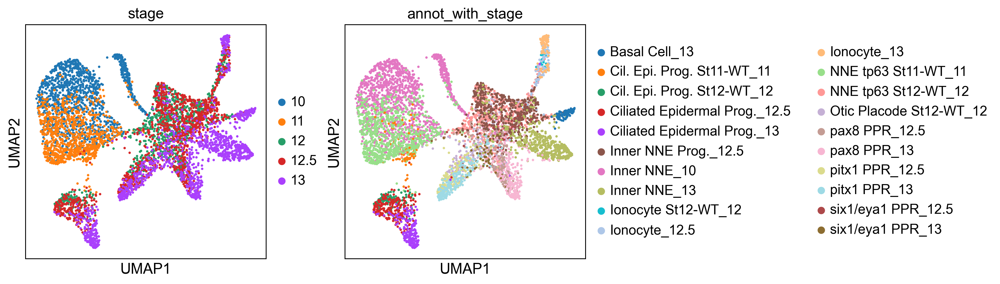

In [29]:
import scanpy as sc
import scanpy.external as sce

#sc.pp.pca(adata_HVG, n_comps=94)
# Increase the number of PCs and neighbors to see how that affects the graph
sce.pp.bbknn(
    adata_HVG, 
    batch_key='stage',
    n_pcs=10,           # Use more principal components (tune this)
    neighbors_within_batch=100,     # Increase the number of nearest neighbors
)

# Then, visualize the effect on UMAP
sc.tl.umap(adata_HVG)
sc.pl.umap(adata_HVG, color=['stage', 'annot_with_stage'])


In [30]:
sc.tl.leiden(adata_HVG, key_added='leiden')

C:\Users\coron\miniconda3\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


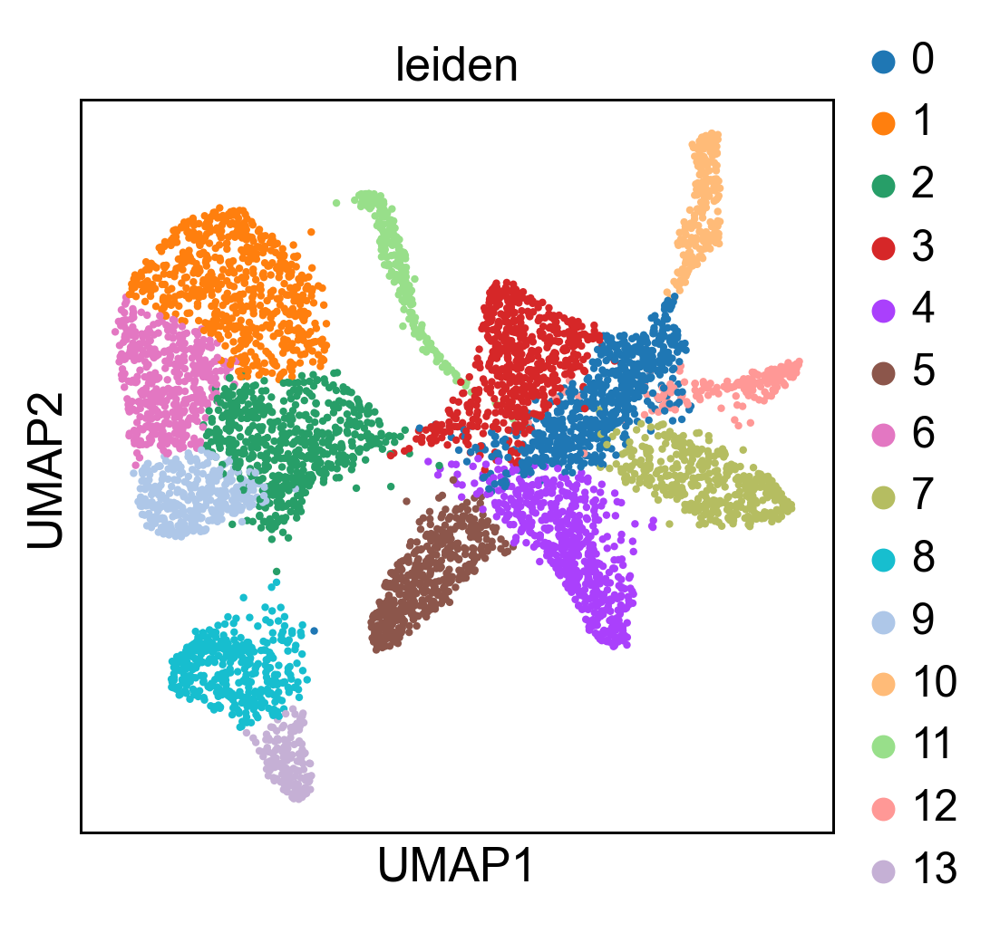

In [31]:
sc.pl.umap(adata_HVG, color=[ 'leiden'])

In [32]:
adata_HVG = adata_HVG[adata_HVG.obs['leiden'] != '11'].copy()

C:\Users\coron\miniconda3\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


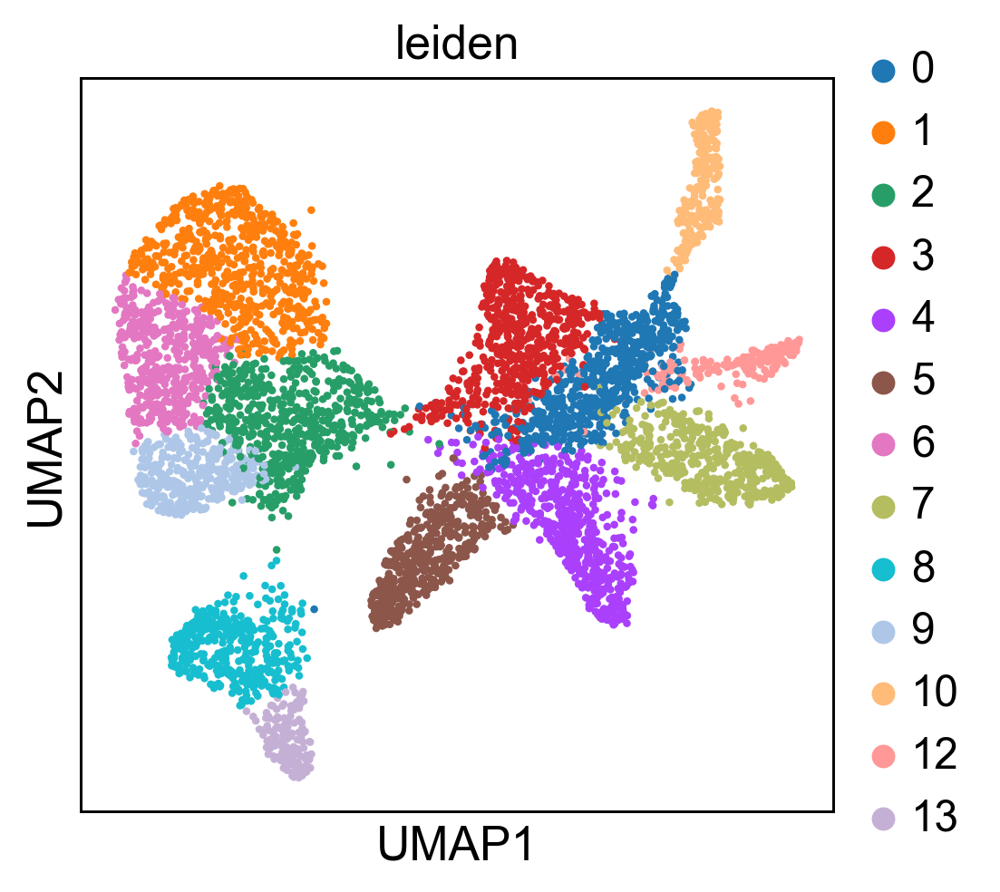

In [33]:
sc.pl.umap(adata_HVG, color=['leiden'])

# Calculating Principle Graph

In [34]:
import numpy as np
from sklearn.cluster import KMeans

def _safe_get_partition_modes(mat, init_nodes_pos, labels):
    kmeans = KMeans(n_clusters=len(init_nodes_pos), n_init='auto', random_state=42)
    part = kmeans.fit_predict(mat)
    modes = np.empty(len(init_nodes_pos), dtype=labels.dtype)

    for i in range(len(init_nodes_pos)):
        group = labels[part == i]
        if len(group) == 0:
            # fallback: assign most common label overall
            fallback = np.unique(labels, return_counts=True)[0][0]
            modes[i] = fallback
        else:
            unique_vals, counts = np.unique(group, return_counts=True)
            modes[i] = unique_vals[np.argmax(counts)]

    return modes

# Patch it in
import stream2.tools._elpigraph as _elpigraph
_elpigraph._get_partition_modes = _safe_get_partition_modes


In [37]:
# Convert to categorical codes
adata_HVG.obs['annot_with_stage'] = adata_HVG.obs['annot_with_stage'].astype('category')

# Store the mapping
stage_code_mapping = dict(enumerate(adata_HVG.obs['annot_with_stage'].cat.categories))

# Save numeric codes to a new column
adata_HVG.obs['annot_with_stage_num'] = adata_HVG.obs['annot_with_stage'].cat.codes

for k, v in stage_code_mapping.items():
    print(f"{k}: {v}")

0: Basal Cell_13
1: Cil. Epi. Prog. St11-WT_11
2: Cil. Epi. Prog. St12-WT_12
3: Ciliated Epidermal Prog._12.5
4: Ciliated Epidermal Prog._13
5: Inner NNE Prog._12.5
6: Inner NNE_10
7: Inner NNE_13
8: Ionocyte St12-WT_12
9: Ionocyte_12.5
10: Ionocyte_13
11: NNE tp63 St11-WT_11
12: NNE tp63 St12-WT_12
13: Otic Placode St12-WT_12
14: pax8 PPR_12.5
15: pax8 PPR_13
16: pitx1 PPR_12.5
17: pitx1 PPR_13
18: six1/eya1 PPR_12.5
19: six1/eya1 PPR_13


In [38]:
paths_favored = [
    [6, 11],  # Inner NNE_10 → NNE tp63 St11-WT_11
    [11, 12], # → NNE tp63 St12-WT_12
    [12, 5],  # → Inner NNE Prog._12.5
    [5, 7],   # → Inner NNE_13

    [6, 1],   # Inner NNE_10 → Cil. Epi. Prog. St11-WT_11
    [1, 2],   # → Cil. Epi. Prog. St12-WT_12
    [2, 3],   # → Ciliated Epidermal Prog._12.5
    [3, 4],   # → Ciliated Epidermal Prog._13

    [11, 8],  # NNE tp63 St11-WT_11 → Ionocyte St12-WT_12
    [8, 9],   # → Ionocyte_12.5
    [9, 10],  # → Ionocyte_13

    [11, 13], # → Otic Placode St12-WT_12
    [13, 14], # → pax8 PPR_12.5
    [14, 15], # → pax8 PPR_13

    [13, 16], # Otic Placode St12-WT_12 → pitx1 PPR_12.5
    [16, 17], # → pitx1 PPR_13

    [13, 18], # Otic Placode St12-WT_12 → six1/eya1 PPR_12.5
    [18, 19], # → six1/eya1 PPR_13

    [7, 0]    # Inner NNE_13 → Basal Cell_13
]

st2.tl.seed_graph(
    adata_HVG,
    obsm="X_umap",
    n_clusters=10,
    label="annot_with_stage_num",
    label_strength=100.0,
    paths_favored=paths_favored,
    #paths_disfavored=paths_disfavored,
    use_weights=True
)


Seeding initial graph...
Clustering...
K-Means clustering ...
Calculating minimum spanning tree...
Found label(s) [ 0  1  2  4  8  9 13 14 16 17 18 19] with no representative node. Adding label centroid(s) as node(s)


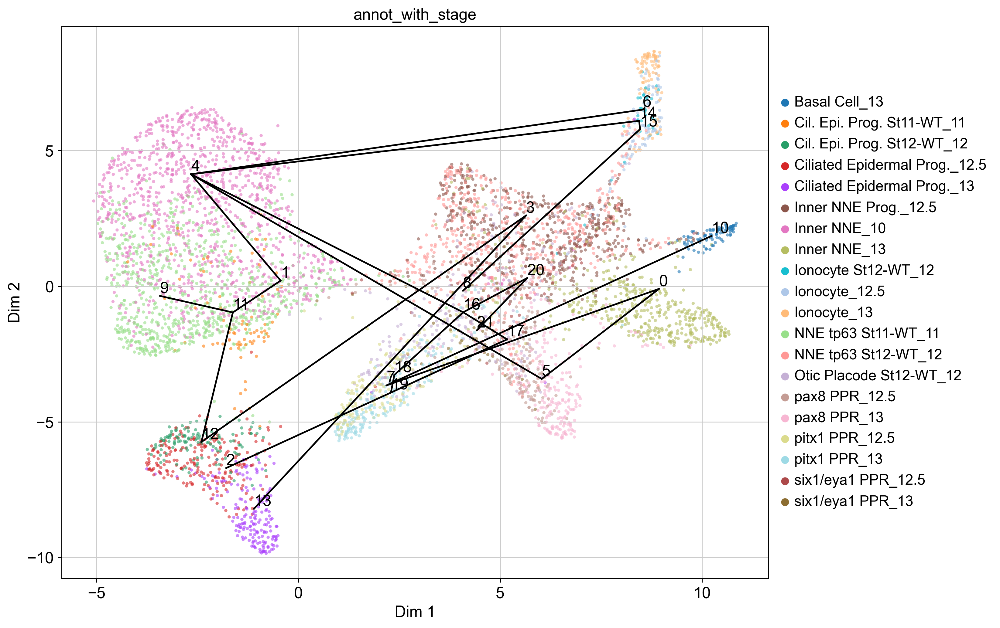

In [39]:
st2.pl.graph(adata_HVG,show_text=True,alpha=0.6,color=['annot_with_stage'],key='seed_epg', fig_size=(12, 8))


In [40]:
#75 other
st2.tl.learn_graph(adata_HVG, obsm='X_umap', n_nodes=75, method='principal_tree',)

Maximum number of iterations ( 10 ) has been reached. diff =  0.01235401492313344


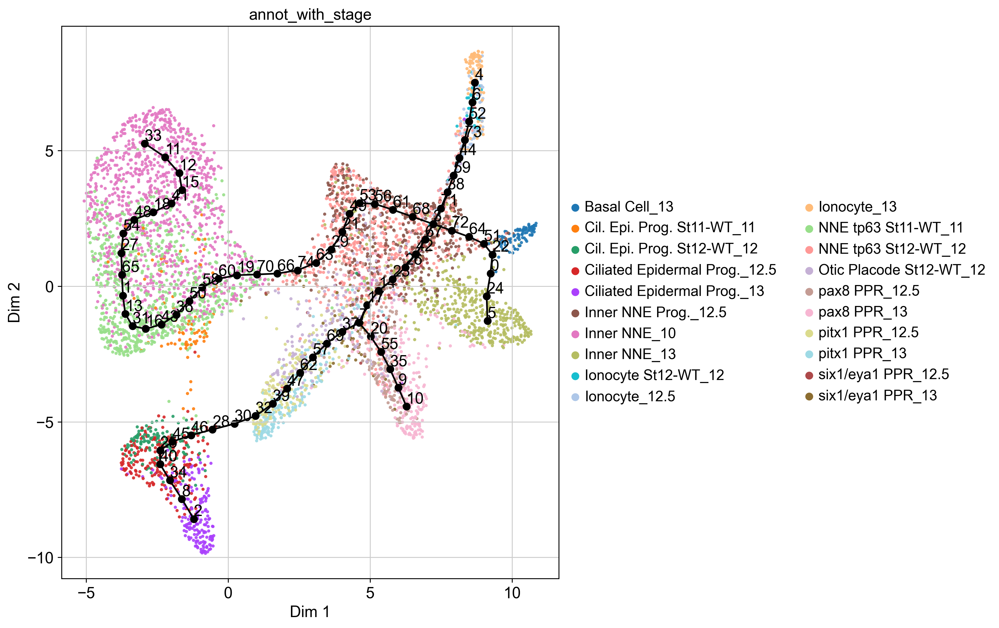

In [42]:
st2.pl.graph(
    adata_HVG,
    color=['annot_with_stage'],
    show_text=True,
    show_node=True,
    fig_legend_ncol=2,
    fig_size=(12, 8),               # Make figure larger
             # Optional: reduce legend font size
)


In [43]:
st2.tl.del_path(adata_HVG,25,39)

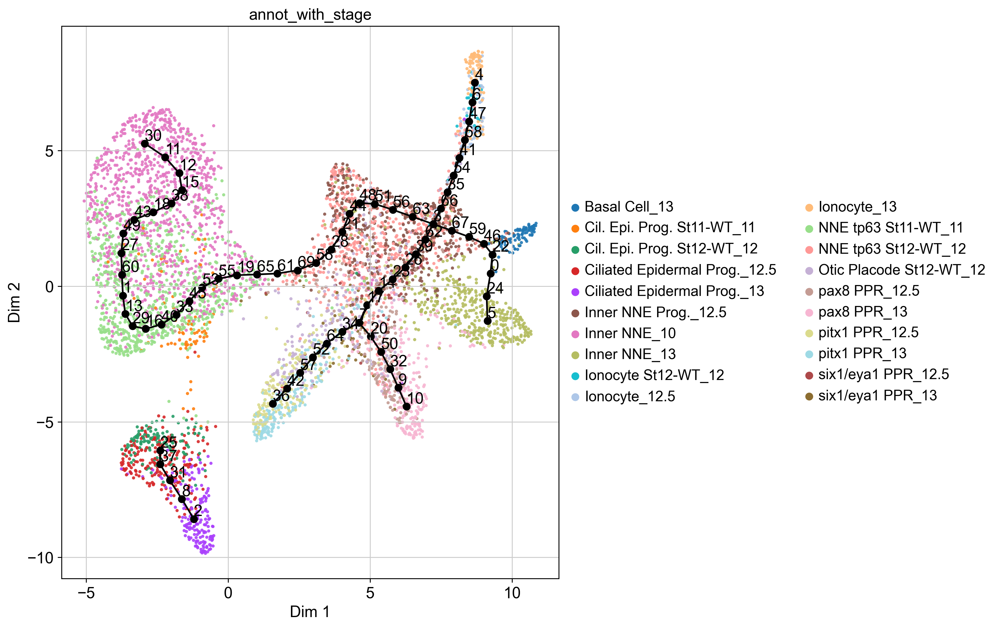

In [44]:
st2.pl.graph(
    adata_HVG,
    color=['annot_with_stage'],
    show_text=True,
    show_node=True,
    fig_legend_ncol=2,
    fig_size=(12, 8),               # Make figure larger
             # Optional: reduce legend font size
)


In [46]:
st2.tl.add_path(adata_HVG,26,5,n_nodes=0)

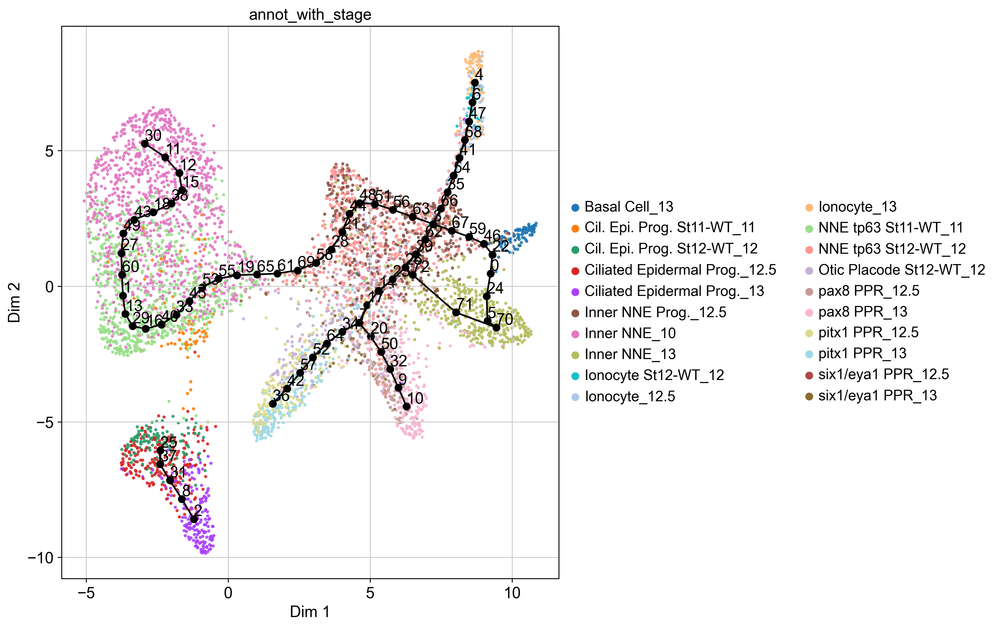

In [47]:
st2.pl.graph(
    adata_HVG,
    color=['annot_with_stage'],
    show_text=True,
    show_node=True,
    fig_legend_ncol=2,
    fig_size=(12, 8),               # Make figure larger
             # Optional: reduce legend font size
)


In [48]:
st2.tl.del_path(adata_HVG,70,46)

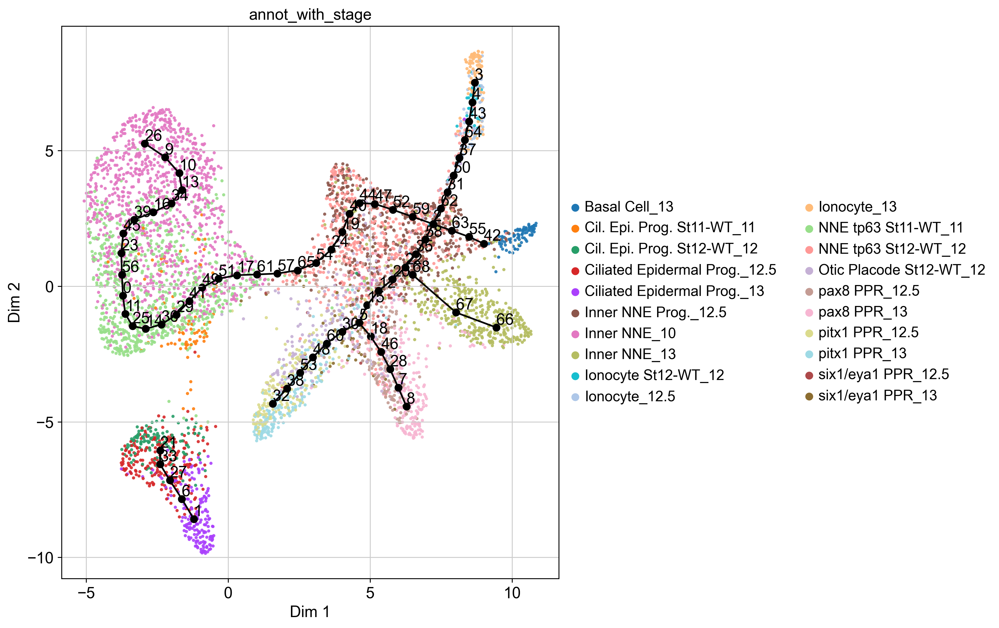

In [49]:
st2.pl.graph(
    adata_HVG,
    color=['annot_with_stage'],
    show_text=True,
    show_node=True,
    fig_legend_ncol=2,
    fig_size=(12, 8),               # Make figure larger
             # Optional: reduce legend font size
)


In [51]:
st2.tl.add_path(adata_HVG,29,21,n_nodes=0)

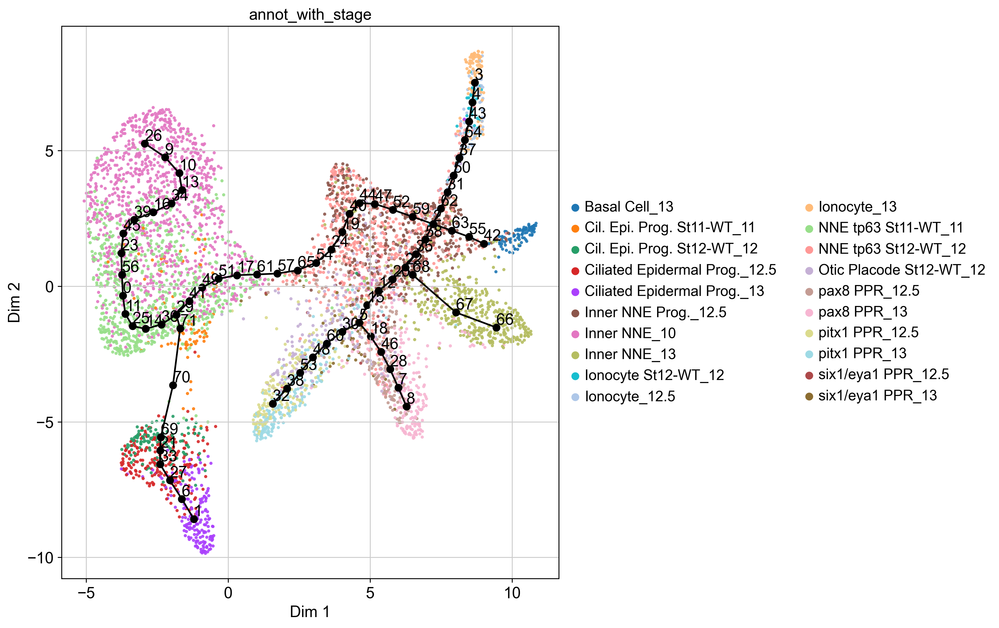

In [52]:
st2.pl.graph(
    adata_HVG,
    color=['annot_with_stage'],
    show_text=True,
    show_node=True,
    fig_legend_ncol=2,
    fig_size=(12, 8),               # Make figure larger
             # Optional: reduce legend font size
)


In [53]:
st2.tl.add_path(adata_HVG,65,5,n_nodes=0)

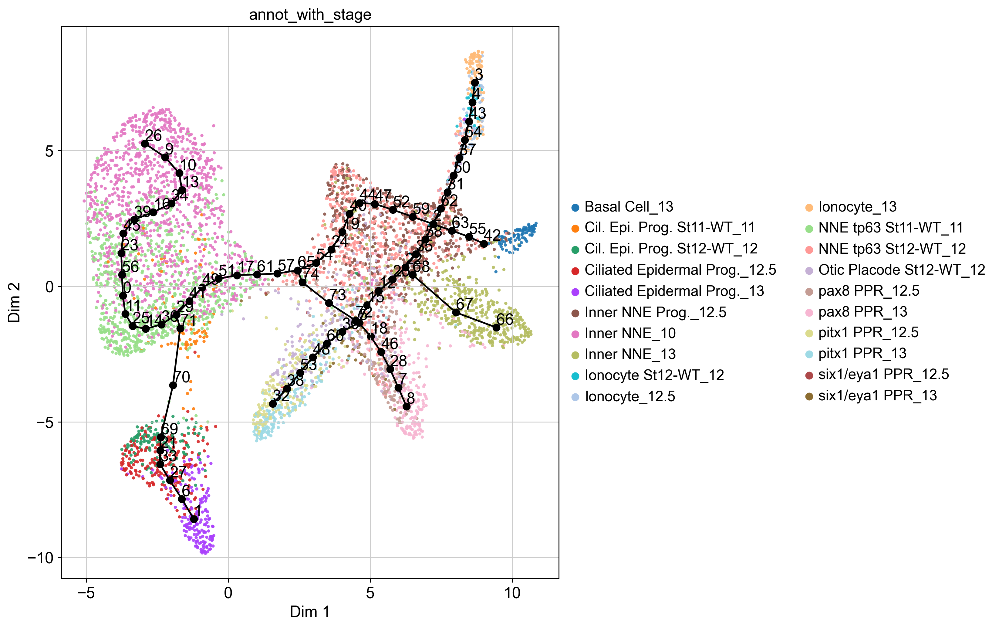

In [54]:
st2.pl.graph(
    adata_HVG,
    color=['annot_with_stage'],
    show_text=True,
    show_node=True,
    fig_legend_ncol=2,
    fig_size=(12, 8),               # Make figure larger
             # Optional: reduce legend font size
)


In [55]:
st2.tl.del_path(adata_HVG,20,5)

In [60]:
st2.tl.add_path(adata_HVG,39,[10.5,1.8],n_nodes=None,epg_mu=1)

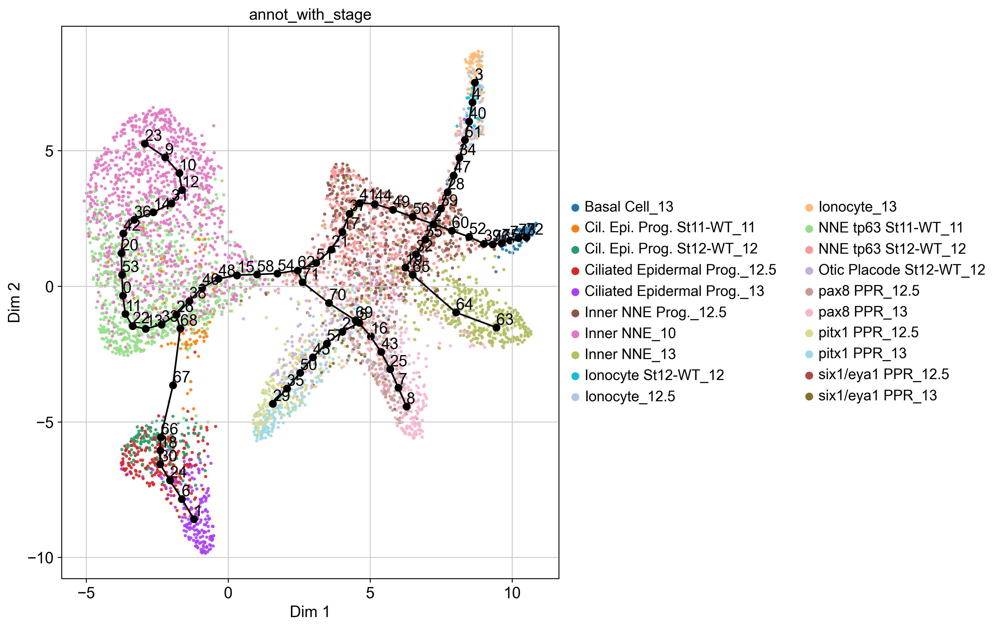

In [61]:
st2.pl.graph(
    adata_HVG,
    color=['annot_with_stage'],
    show_text=True,
    show_node=True,
    fig_legend_ncol=2,
    fig_size=(12, 8),               # Make figure larger
             # Optional: reduce legend font size
)


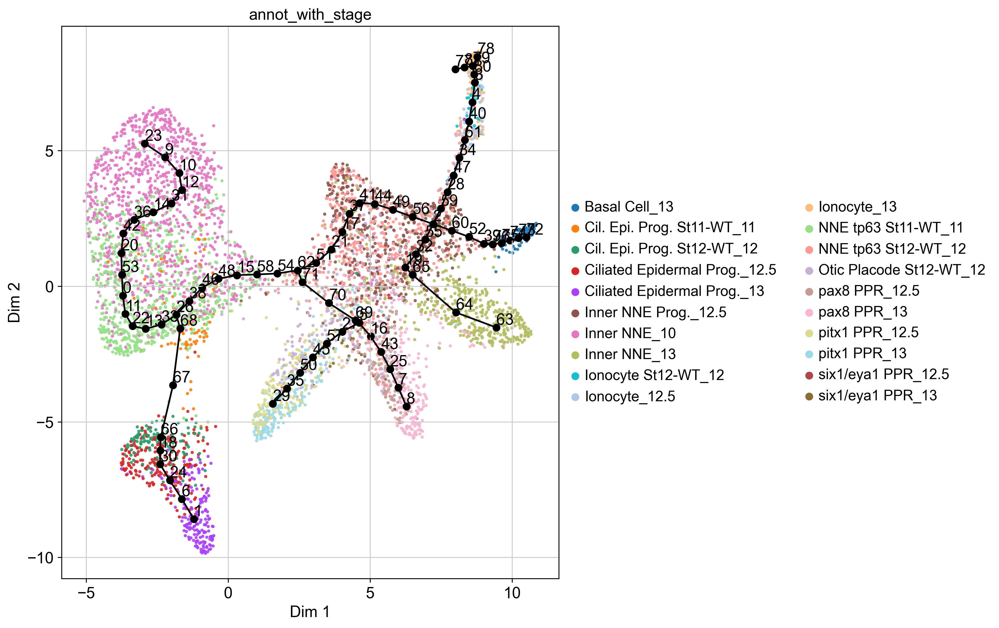

In [63]:
st2.pl.graph(
    adata_HVG,
    color=['annot_with_stage'],
    show_text=True,
    show_node=True,
    fig_legend_ncol=2,
    fig_size=(12, 8),               # Make figure larger
             # Optional: reduce legend font size
)


In [64]:
st2.tl.del_path(adata_HVG,77,79)

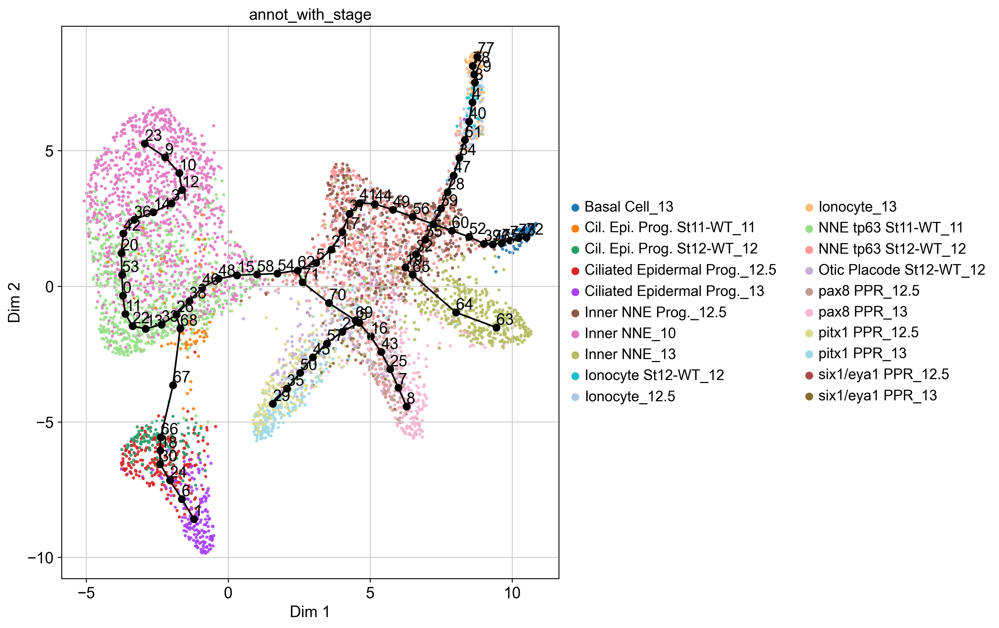

In [65]:
st2.pl.graph(
    adata_HVG,
    color=['annot_with_stage'],
    show_text=True,
    show_node=True,
    fig_legend_ncol=2,
    fig_size=(12, 8),               # Make figure larger
             # Optional: reduce legend font size
)


# Final Figures

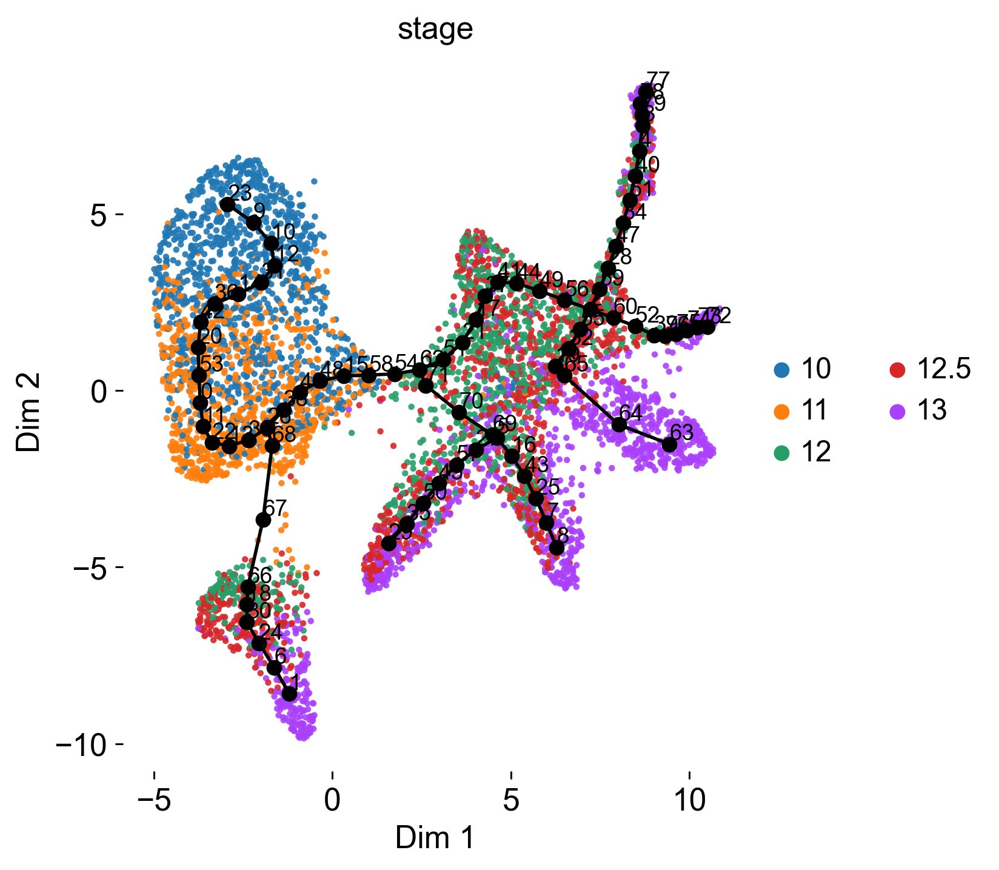

In [137]:
import matplotlib.pyplot as plt

# Plot the STREAM2 graph
st2.pl.graph(
    adata_HVG,
    color=['stage'],
    show_text=True,
    show_node=True,
    fig_legend_ncol=2,
    fig_size=(6, 5.5)
)

# Modify all axes: turn off grid and remove the frame (spines)
for ax in plt.gcf().axes:
    ax.grid(False)  # Remove grid
    for spine in ax.spines.values():
        spine.set_visible(False)  # Remove all spines (frame)

plt.show()


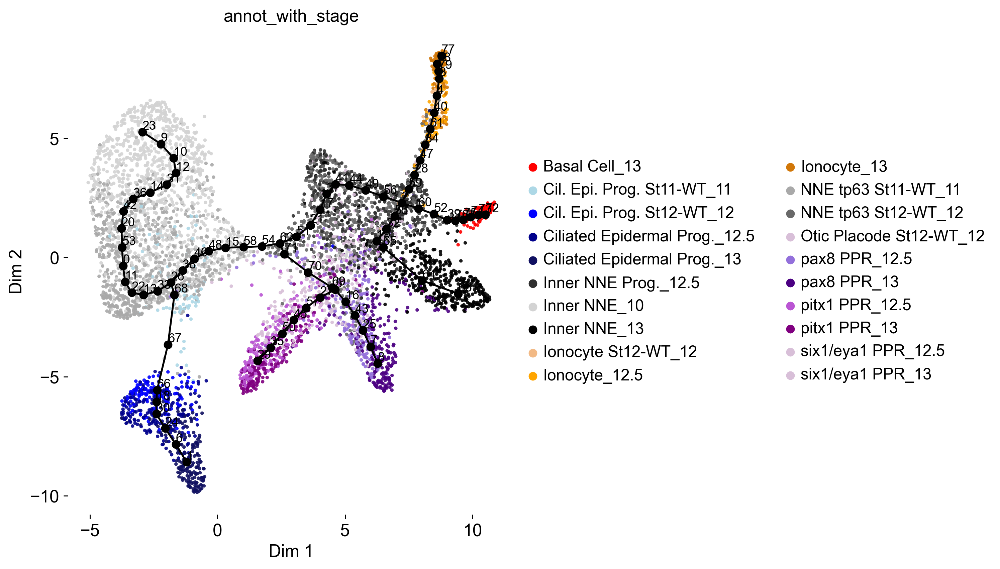

In [154]:
import matplotlib.pyplot as plt

# Plot the STREAM2 graph
st2.pl.graph(
    adata_HVG,
    color=['annot_with_stage'],
    show_text=True,
    show_node=True,
    fig_legend_ncol=2,
    fig_size=(10.8, 6.5),
    dict_palette={'annot_with_stage': custom_palette},  # <-- this is key
)

# Modify all axes: turn off grid and remove the frame (spines)
for ax in plt.gcf().axes:
    ax.grid(False)  # Remove grid
    for spine in ax.spines.values():
        spine.set_visible(False)  # Remove all spines (frame)

plt.show()


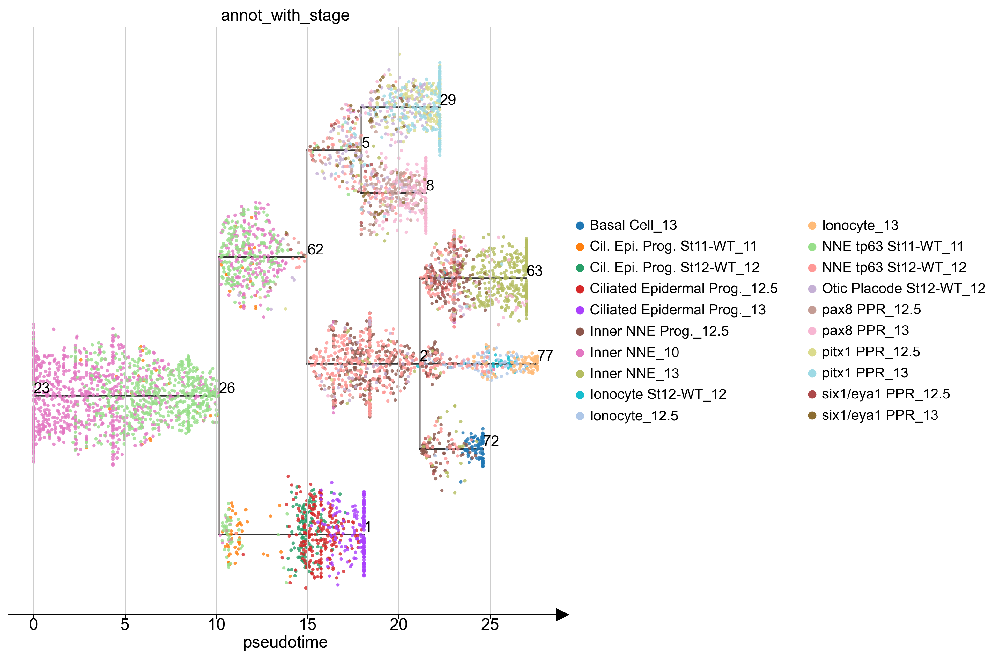

In [69]:
import matplotlib.pyplot as plt

# Run your original plotting function without the unsupported argument
st2.pl.stream_sc(adata_HVG, 
                 source=23, 
                 dist_scale=1, 
                 color=['annot_with_stage'],
                 fig_ncol=2,
                 fig_legend_ncol=2,
                 fig_size=(12, 8),  # You can use this!
                 save_fig=False)

# Now modify the plot
fig = plt.gcf()
fig.set_size_inches(12, 8)  # Bigger figure size

# Adjust legend font size
for ax in fig.axes:
    leg = ax.get_legend()
    if leg:
        for text in leg.get_texts():
            text.set_fontsize(12)  # Smaller legend text
        leg.set_title(leg.get_title().get_text(), prop={'size': 12})  # Smaller legend title

plt.tight_layout()
plt.show()


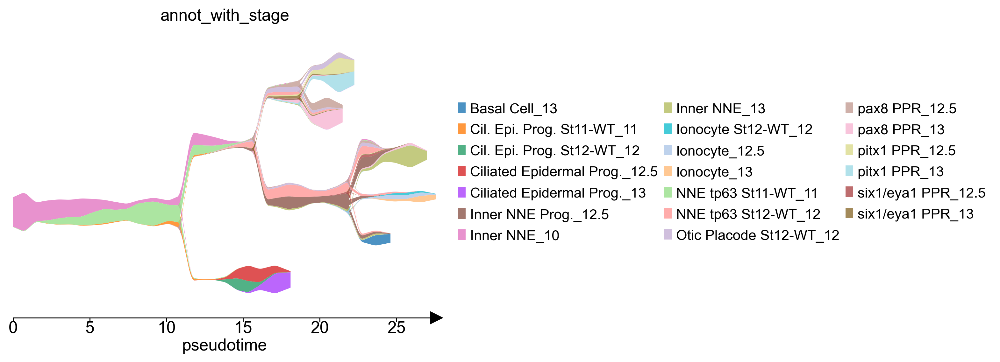

In [70]:
import matplotlib.pyplot as plt

# Run your original plotting function
st2.pl.stream(
    adata_HVG, 
    source=23, 
    dist_scale=1, 
    color=['annot_with_stage'],
    fig_legend_ncol=3,
    fig_size=(12, 4.5),  # Acceptable argument
    save_fig=False
)

# Modify the plot
fig = plt.gcf()
fig.set_size_inches(12, 4.5)  # Bigger figure size

# Remove gridlines and adjust legend font size
for ax in fig.axes:
    ax.grid(False)  # Turn off gridlines
    leg = ax.get_legend()
    if leg:
        for text in leg.get_texts():
            text.set_fontsize(12)  # Adjust legend text size
        leg.set_title(leg.get_title().get_text(), prop={'size': 12})  # Adjust legend title size

plt.tight_layout()
plt.show()


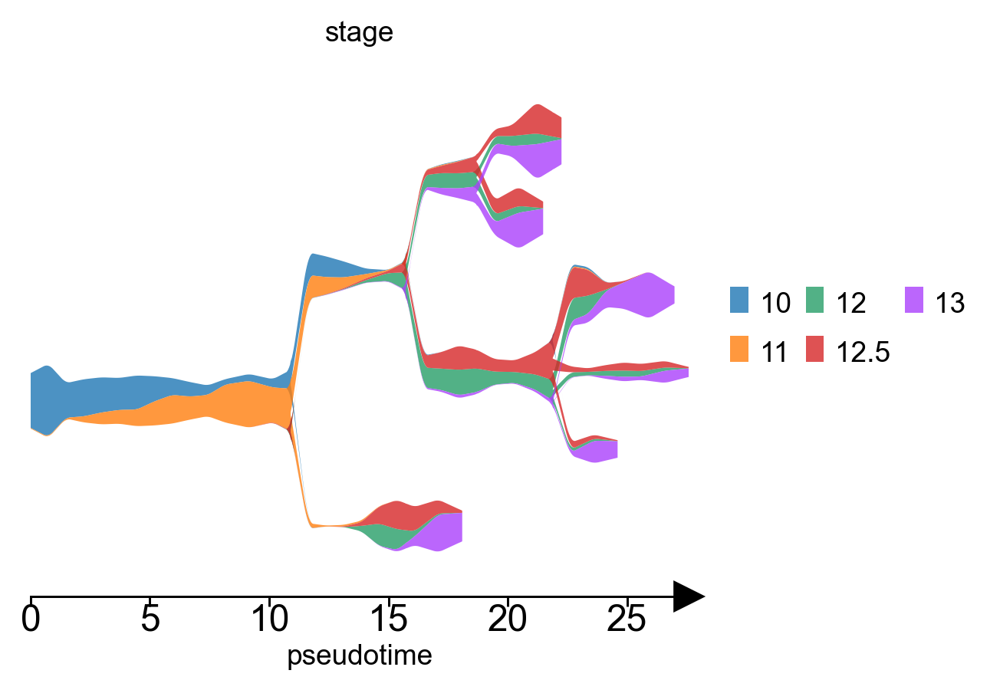

In [79]:
import matplotlib.pyplot as plt

# Run your original plotting function
st2.pl.stream(
    adata_HVG, 
    source=23, 
    dist_scale=1, 
    color=['stage'],
    fig_legend_ncol=3,
    fig_size=(5, 3.5),
    save_fig=False
)

# Modify the plot
fig = plt.gcf()
fig.set_size_inches(5, 3.5)

for ax in fig.axes:
    ax.grid(False)  # Remove gridlines

    # Update tick label font sizes
    ax.tick_params(axis='both', labelsize=13)

    # Update axis label font sizes
    if ax.get_xlabel():
        ax.set_xlabel(ax.get_xlabel(), fontsize=10)
    if ax.get_ylabel():
        ax.set_ylabel(ax.get_ylabel(), fontsize=10)

    # Update title font size if present
    if ax.get_title():
        ax.set_title(ax.get_title(), fontsize=10)

    # Update legend font sizes
    leg = ax.get_legend()
    if leg:
        for text in leg.get_texts():
            text.set_fontsize(10)
        leg.set_title(leg.get_title().get_text(), prop={'size': 10})

plt.tight_layout()
plt.show()


In [152]:
custom_palette = {
    'Basal Cell_13': '#FF0000',
    'Cil. Epi. Prog. St11-WT_11': '#ADD8E6',
    'Cil. Epi. Prog. St12-WT_12': '#0000FF',
    'Ciliated Epidermal Prog._12.5': '#00008B',
    'Ciliated Epidermal Prog._13': '#101061',
    'Inner NNE Prog._12.5': '#2F2F2F',
    'Inner NNE_10': '#D3D3D3',
    'Inner NNE_13': '#000000',
    'Ionocyte St12-WT_12': '#f2b985',
    'Ionocyte_12.5': '#FFA500',
    'Ionocyte_13': '#d17708',
    'NNE tp63 St11-WT_11': '#A9A9A9',
    'NNE tp63 St12-WT_12': '#696969',
    'Otic Placode St12-WT_12': '#D8BFD8',
    'pax8 PPR_12.5': '#9370DB',
    'pax8 PPR_13': '#4B0082',
    'pitx1 PPR_12.5': '#BA55D3',
    'pitx1 PPR_13': '#800080',
    'six1/eya1 PPR_12.5': '#D8BFD8',
    'six1/eya1 PPR_13': '#D8BFD8'
}


In [150]:
categories = adata_HVG.obs['annot_with_stage'].cat.categories
palette = [custom_palette[cat] for cat in categories]


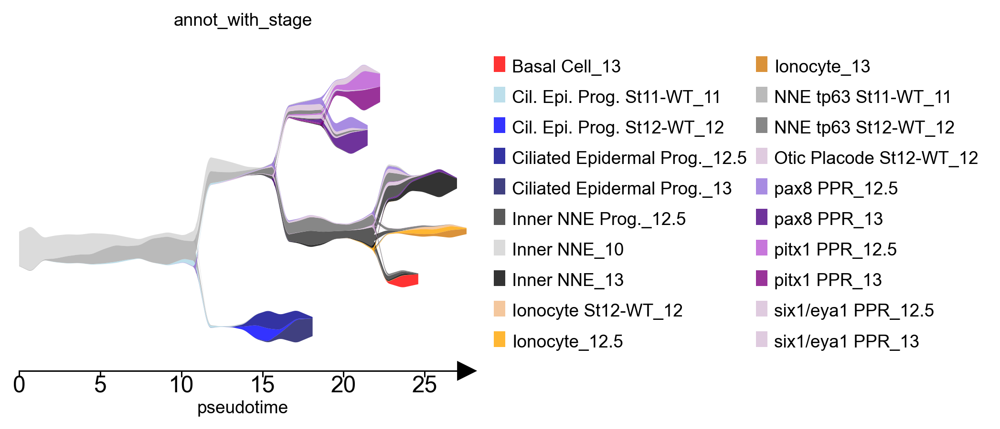

In [153]:
st2.pl.stream(
    adata_HVG,
    source=23,
    dist_scale=1,
    color='annot_with_stage',
    dict_palette={'annot_with_stage': custom_palette},  # <-- this is key
    fig_legend_ncol=2,
    fig_size=(12, 4.5),
    save_fig=False
)

# Modify the plot
fig = plt.gcf()
fig.set_size_inches(8, 3.5)

for ax in fig.axes:
    ax.grid(False)  # Remove gridlines

    # Update tick label font sizes
    ax.tick_params(axis='both', labelsize=13)

    # Update axis label font sizes
    if ax.get_xlabel():
        ax.set_xlabel(ax.get_xlabel(), fontsize=10)
    if ax.get_ylabel():
        ax.set_ylabel(ax.get_ylabel(), fontsize=10)

    # Update title font size if present
    if ax.get_title():
        ax.set_title(ax.get_title(), fontsize=10)

    # Update legend font sizes
    leg = ax.get_legend()
    if leg:
        for text in leg.get_texts():
            text.set_fontsize(10)
        leg.set_title(leg.get_title().get_text(), prop={'size': 10})

plt.tight_layout()
plt.show()


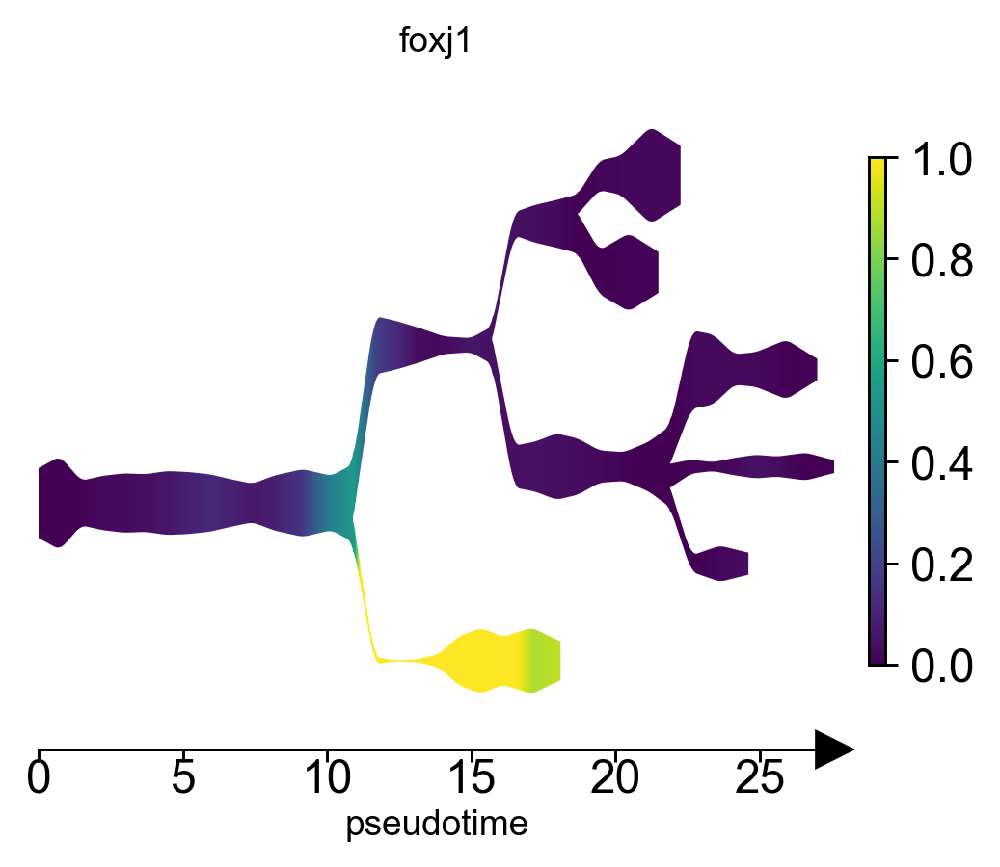

In [187]:
st2.pl.stream(
    adata_HVG,
    source=23,
    dist_scale=1,
    color='foxj1',
    dict_palette={'annot_with_stage': custom_palette},  # <-- this is key
    fig_legend_ncol=2,
    fig_size=(12, 4.5),
    save_fig=False,
    vmax=1
)

# Modify the plot
fig = plt.gcf()
fig.set_size_inches(4, 3.5)

for ax in fig.axes:
    ax.grid(False)  # Remove gridlines

    # Update tick label font sizes
    ax.tick_params(axis='both', labelsize=13)

    # Update axis label font sizes
    if ax.get_xlabel():
        ax.set_xlabel(ax.get_xlabel(), fontsize=10)
    if ax.get_ylabel():
        ax.set_ylabel(ax.get_ylabel(), fontsize=10)

    # Update title font size if present
    if ax.get_title():
        ax.set_title(ax.get_title(), fontsize=10)

    # Update legend font sizes
    leg = ax.get_legend()
    if leg:
        for text in leg.get_texts():
            text.set_fontsize(10)
        leg.set_title(leg.get_title().get_text(), prop={'size': 10})

plt.tight_layout()
plt.show()
